In [82]:
import chess
import cv2 as cv
import matplotlib.pyplot as plt
import os
import chess.svg
from IPython.display import SVG, display
from concurrent.futures import ThreadPoolExecutor, as_completed
from detectors.chess_position_detector import ChessPositionDetector
from PIL import Image 
import numpy as np

In [83]:
img_folder_path = "C:/Users/user/Downloads/long_video"

original_imgs = []
for img_name in os.listdir(img_folder_path):
    full_path = os.path.join(img_folder_path, img_name)
    if os.path.isfile(full_path):
        img = cv.imread(full_path, cv.IMREAD_COLOR)
        if img is not None:  # Ensure valid image
            original_imgs.append(img)


chess_position_detector = ChessPositionDetector()

fens = []
cnt = 0
for oimg in (original_imgs):
    cnt += 1
    fens.append(chess_position_detector.detect(oimg))

for fen in fens:
    if fen is not None:
        print('FEN: {}'.format(fen))
    else:
        print('Error: Could not detect FEN for an image.')


c:\Users\user\miniconda3\envs\digimg\lib\site-packages\ultralytics\nn\tasks.py:708: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(file, map_location="cpu")

FEN: RRBKQBNR/PPPPPPPB/8/8/8/8/pppppppp/rnbkqbnr
FEN: RRBKQ1N1/PPPPPPPB/8/8/8/8/pppppp2/rnb3pp
FEN: RRBKNBNR/PP1PPPPB/8/2B5/8/8/pppppppp/rnbkqbnr
FEN: RRBKQBNR/PP1PPPPB/8/2B5/8/8/ppppppbp/rnbkqbnr
FEN: RNBKQBNR/PP1PPPPB/8/2B5/4p3/8/pppp1pbp/rnbkqknr
FEN: R1BKQBNR/BP1PPPBB/2N5/2P5/4p3/8/pppp1ppp/rnbkqbnr
FEN: R1BKQBNR/BP1PPPPB/2N5/2P5/4p3/8/pppp1ppp/rnbkqbnr
FEN: R1BKQBNR/BP1PPPPB/2P5/2P5/4p3/8/pppp1ppp/rnbkkknr
FEN: R1BKQBNR/BP1PPPPB/2N5/2P5/8/2b1p3/8/pqpp1ppp
FEN: R1BKQBNR/PP1PPPPB/2N5/2P5/2b1p3/8/pppp1npp/rnbkk1nr
FEN: R1BBQBN1/PP1PPPBB/2N5/2P5/2b1p3/8/pppp1pbp/rnbkq1nr
FEN: R1BKQB1R/PP1PPPBB/2N2N2/2P5/2p1p3/8/pppp1pbp/rnbkk1nr
FEN: R1BKQB1R/BP1PPPBB/2N2N2/2P5/2b1p3/5n2/pppp1ppp/rnbkk2r
FEN: R1BKQB1R/BP1PPPPB/2N5/2P5/2b1N3/5n2/pqpp1pbp/rnbkq2r
FEN: R1BKNB1R/BP1PPPPB/2N5/2P5/2b1N3/5n2/pppp1bpp/rnbkk2r
FEN: R1BKQB2/BP1PPPPB/2N5/2P5/2b1N3/5n2/pqpp1ppp/rnbkq2r
FEN: R1BKQB1R/BP1PPPPB/2N5/2P5/2b1N3/5n2/pqpp1bpp/rnbkk2r
FEN: R1BKQB1R/BP1PPPPB/2N5/2P5/2b1N3/5n2/pppp1ppp/rnbqk2r
FEN: R1BKQB1R

In [84]:
def count_pieces_in_section(fen_part):
    white_count = sum(1 for c in fen_part if c.isupper())
    black_count = sum(1 for c in fen_part if c.islower())
    return white_count, black_count

def expand_fen_rank(rank):
    expanded = ''
    for char in rank:
        if char.isdigit():
            expanded += '.' * int(char)
        else:
            expanded += char
    return expanded

def compress_rank(expanded_rank):
    result = ''
    empty_count = 0
    for char in expanded_rank:
        if char == '.':
            empty_count += 1
        else:
            if empty_count > 0:
                result += str(empty_count)
                empty_count = 0
            result += char
    if empty_count > 0:
        result += str(empty_count)
    return result

def analyze_fen(fen):
    ranks = fen.split('/')
    expanded_ranks = [expand_fen_rank(rank) for rank in ranks]
    
    left_white = left_black = right_white = right_black = 0
    top_white = top_black = bottom_white = bottom_black = 0
    
    for i, rank in enumerate(expanded_ranks):
        mid = len(rank) // 2
        left_half = rank[:mid]
        right_half = rank[mid:]
        
        w_count, b_count = count_pieces_in_section(left_half)
        left_white += w_count
        left_black += b_count
        
        w_count, b_count = count_pieces_in_section(right_half)
        right_white += w_count
        right_black += b_count
        
        if i < 4:
            top_white += sum(1 for c in rank if c.isupper())
            top_black += sum(1 for c in rank if c.islower())
        else:
            bottom_white += sum(1 for c in rank if c.isupper())
            bottom_black += sum(1 for c in rank if c.islower())
    
    return {
        'left': {'white': left_white, 'black': left_black},
        'right': {'white': right_white, 'black': right_black},
        'top': {'white': top_white, 'black': top_black},
        'bottom': {'white': bottom_white, 'black': bottom_black}
    }

def rotate_90_ccw(fen):
    ranks = fen.split('/')
    expanded_ranks = [expand_fen_rank(rank) for rank in ranks]
    
    # Create a matrix of the position
    matrix = [list(rank) for rank in expanded_ranks]
    
    # Rotate 90 degrees counterclockwise
    rotated = list(zip(*matrix))[::-1]
    
    # Convert back to FEN format
    new_ranks = []
    for rank in rotated:
        new_ranks.append(compress_rank(''.join(rank)))
    
    return '/'.join(new_ranks)

def rotate_180(fen):
    ranks = fen.split('/')
    rotated_ranks = []
    
    for rank in ranks:
        expanded = expand_fen_rank(rank)
        rotated = expanded[::-1]
        rotated_ranks.append(compress_rank(rotated))
    
    return '/'.join(rotated_ranks[::-1])

def rotate_270_ccw(fen):
    # Same as 90 degrees clockwise
    ranks = fen.split('/')
    expanded_ranks = [expand_fen_rank(rank) for rank in ranks]
    
    # Create a matrix of the position
    matrix = [list(rank) for rank in expanded_ranks]
    
    # Rotate 270 degrees counterclockwise (90 degrees clockwise)
    rotated = list(zip(*matrix[::-1]))
    
    # Convert back to FEN format
    new_ranks = []
    for rank in rotated:
        new_ranks.append(compress_rank(''.join(rank)))
    
    return '/'.join(new_ranks)

def find_best_rotation(fen):
    # Generate all possible rotations
    rotations = {
        '0': fen,
        '90': rotate_90_ccw(fen),
        '180': rotate_180(fen),
        '270': rotate_270_ccw(fen)
    }
    
    # Find which rotation has the most white pieces in bottom half
    max_bottom_white = -1
    best_rotation = None
    
    for degrees, rotated_fen in rotations.items():
        analysis = analyze_fen(rotated_fen)
        bottom_white = analysis['bottom']['white']
        
        if bottom_white > max_bottom_white:
            max_bottom_white = bottom_white
            best_rotation = rotated_fen
        
    return best_rotation



In [85]:
def rotate_90_ccw_image(img):
    """
    Rotate a NumPy image 90 degrees counterclockwise
    
    Args:
        img (numpy.ndarray): Input image
    
    Returns:
        numpy.ndarray: Rotated image
    """
    return np.rot90(np.rot90(np.rot90(img, k=1)))
if find_best_rotation(fens[0]) == rotate_90_ccw(fens[0]):
        # Rotate all images 90 degrees counterclockwise
        rotated_imgs = [rotate_90_ccw_image(img) for img in original_imgs]
        fens.clear()
        for oimg in (rotated_imgs):
            fens.append(chess_position_detector.detect(oimg))
        for fen in fens:
            if fen is not None:
                print('FEN: {}'.format(fen))
            else:
                print('Error: Could not detect FEN for an image.')

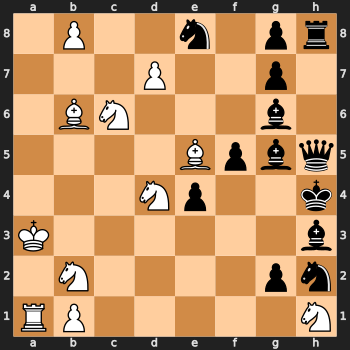

In [86]:
board = chess.Board("1P2n1pr/3P2p1/1BN3b1/4Bpbq/3Np2k/K6b/1N4pn/RP5N")
svg = chess.svg.board(board, size = 350)
display(SVG(svg))

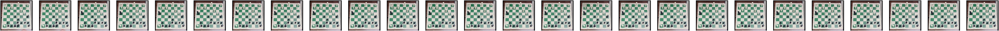

In [87]:
# plt.imshow(cv.cvtColor(original_image1, cv.COLOR_BGR2RGB))
fig, axes = plt.subplots(1, len(rotated_imgs), figsize=(300, 100)) 
for i, ax in enumerate(axes):
    ax.imshow(cv.cvtColor(rotated_imgs[i], cv.COLOR_BGR2RGB))  
    ax.axis('off')  

plt.show()

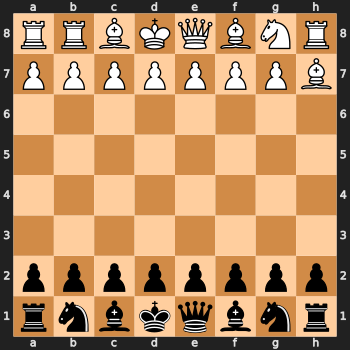

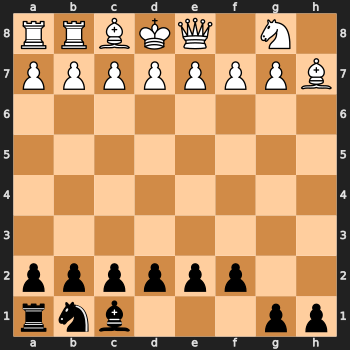

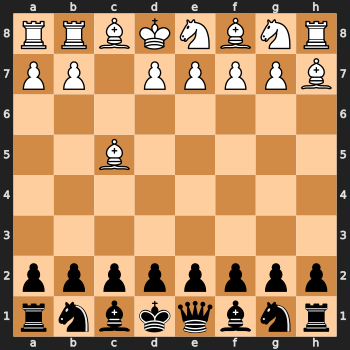

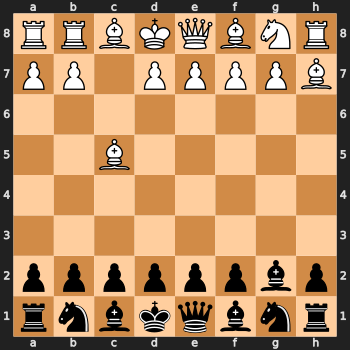

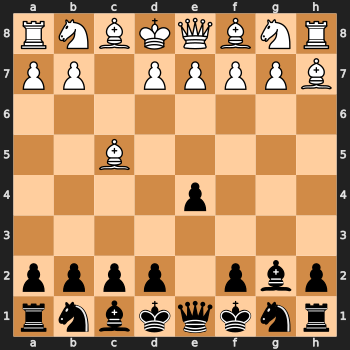

...

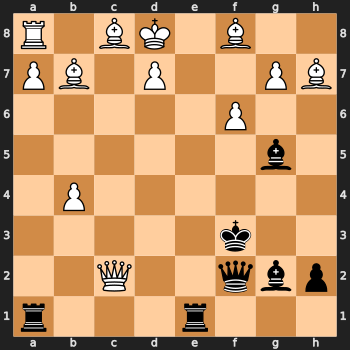

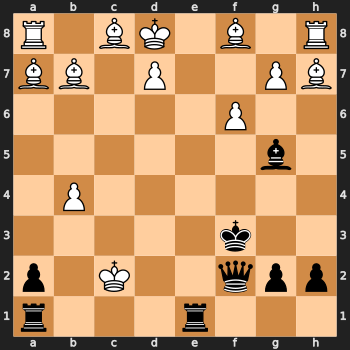

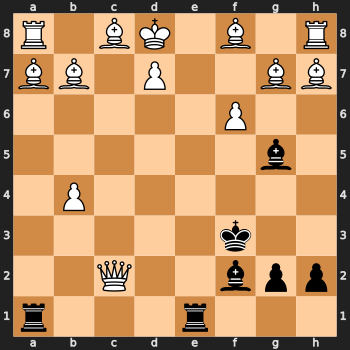

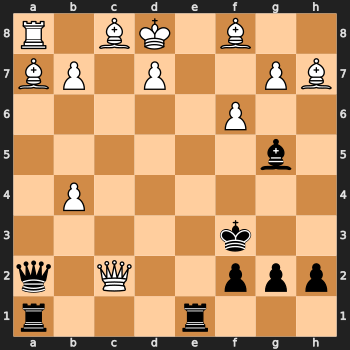

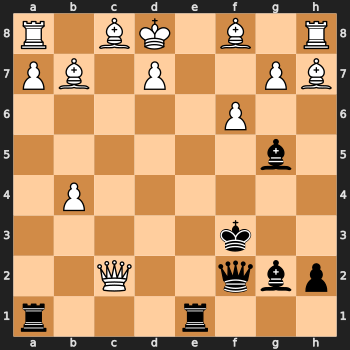

In [88]:
for fen in fens:
        board = chess.Board(fen)
        svg = chess.svg.board(board, size = 350)
        display(SVG(svg))

In [89]:
# plt.imshow(cv.cvtColor(original_image1, cv.COLOR_BGR2RGB))
# fig, axes = plt.subplots(1, len(original_imgs), figsize=(15, 5)) 
fig, axes = plt.subplots(1, len(original_imgs)) 
for i, ax in enumerate(axes):
    ax.imshow(cv.cvtColor(original_imgs[i], cv.COLOR_BGR2RGB))  
    ax.axis('off')  

plt.show()

In [90]:
def parse_fen(fen):
    board_part = fen.split()[0]
    board = []
    for row in board_part.split('/'):
        board_row = []
        for char in row:
            if char.isdigit():
                board_row.extend([''] * int(char))
            else:
                board_row.append(char)
        board.append(board_row)
    return board

def find_move_pgn(previous_fen, current_fen):
    prev_board = parse_fen(previous_fen)
    curr_board = parse_fen(current_fen)
    source = None
    destination = None
    moved_piece = None
    captured_piece = None
    for row in range(8):
        for col in range(8):
            if prev_board[row][col] and prev_board[row][col] != curr_board[row][col]:
                if not curr_board[row][col]:
                    source = (col, row)
                    moved_piece = prev_board[row][col]
                elif curr_board[row][col] != prev_board[row][col]:
                    destination = (col, row)
                    captured_piece = curr_board[row][col]
            elif curr_board[row][col] and not prev_board[row][col]:
                destination = (col, row)
    if source is not None and destination is not None:
        piece_notation = '' if moved_piece.upper() == 'P' else moved_piece.upper()
        source_file_letter = chr(source[0] + ord('a'))
        destination_square = f"{chr(destination[0] + ord('a'))}{8 - destination[1]}"
        capture_symbol = 'x' if captured_piece else ''
        pgn_move = f"{piece_notation}{source_file_letter if moved_piece.upper() == 'P' and captured_piece else ''}{capture_symbol}{destination_square}"
        return pgn_move, moved_piece.islower()
    return "Move could not be determined", False

def execute(fen1, fen2):
    """
    Execute move detection between two FEN positions.
    """
    try:
        move, is_black = find_move_pgn(fen1, fen2)
        if move != "Move could not be determined":
            print(f"Move made: {move}, Is black: {is_black}")
            return [move, is_black]
    except Exception as e:
        print(f"Error: {e}")
        return None

In [91]:

rotated_fens = []
for fen in fens:
    optimized_fen = find_best_rotation(fen)
    rotated_fens.append(optimized_fen)
for rfen in rotated_fens:
    print(rfen)

rnbqkbnr/pppppppp/8/8/8/8/BPPPPPPP/RNBQKBRR
pp3bnr/2pppppp/8/8/8/8/BPPPPPPP/1N1QKBRR
rnbqkbnr/pppppppp/8/8/5B2/8/BPPPP1PP/RNBNKBRR
rnbqkbnr/pbpppppp/8/8/5B2/8/BPPPP1PP/RNBQKBRR
rnkqkbnr/pbp1pppp/8/3p4/5B2/8/BPPPP1PP/RNBQKBNR
rnbqkbnr/ppp1pppp/8/3p4/5P2/5N2/BBPPP1PB/RNBQKB1R
rnbqkbnr/ppp1pppp/8/3p4/5P2/5N2/BPPPP1PB/RNBQKB1R
rnkkkbnr/ppp1pppp/8/3p4/5P2/5P2/BPPPP1PB/RNBQKB1R
ppp1ppqp/8/3p1b2/8/5P2/5N2/BPPPP1PB/RNBQKB1R
rn1kkbnr/ppn1pppp/8/3p1b2/5P2/5N2/BPPPP1PP/RNBQKB1R
rn1qkbnr/pbp1pppp/8/3p1b2/5P2/5N2/BBPPP1PP/1NBQBB1R
rn1kkbnr/pbp1pppp/8/3p1p2/5P2/2N2N2/BBPPP1PP/R1BQKB1R
r2kkbnr/ppp1pppp/2n5/3p1b2/5P2/2N2N2/BBPPP1PB/R1BQKB1R
r2qkbnr/pbp1ppqp/2n5/3N1b2/5P2/5N2/BPPPP1PB/R1BQKB1R
r2kkbnr/ppb1pppp/2n5/3N1b2/5P2/5N2/BPPPP1PB/R1BNKB1R
r2qkbnr/ppp1ppqp/2n5/3N1b2/5P2/5N2/BPPPP1PB/2BQKB1R
r2kkbnr/ppb1ppqp/2n5/3N1b2/5P2/5N2/BPPPP1PB/R1BQKB1R
r2kqbnr/ppp1pppp/2n5/3N1b2/5P2/5N2/BPPPP1PB/R1BQKB1R
r2qkbnr/pbb1ppqp/2n5/3N1b2/5P2/5N2/BPPPP1PB/R1BQKB1R
ppp1pppp/2n5/3N1b2/8/5P2/5N2/BPPPP1PP/R1BQKB1R
r2k

In [92]:
print(rotated_fens[0])
print(parse_fen(rotated_fens[0]))

rnbqkbnr/pppppppp/8/8/8/8/BPPPPPPP/RNBQKBRR
[['r', 'n', 'b', 'q', 'k', 'b', 'n', 'r'], ['p', 'p', 'p', 'p', 'p', 'p', 'p', 'p'], ['', '', '', '', '', '', '', ''], ['', '', '', '', '', '', '', ''], ['', '', '', '', '', '', '', ''], ['', '', '', '', '', '', '', ''], ['B', 'P', 'P', 'P', 'P', 'P', 'P', 'P'], ['R', 'N', 'B', 'Q', 'K', 'B', 'R', 'R']]


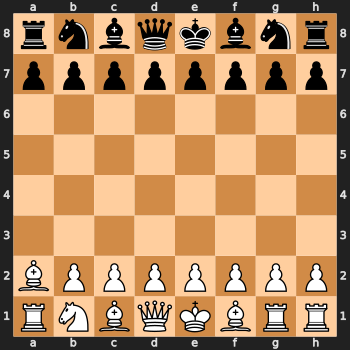

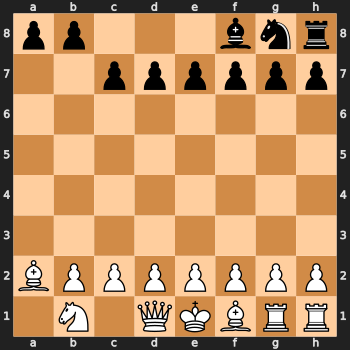

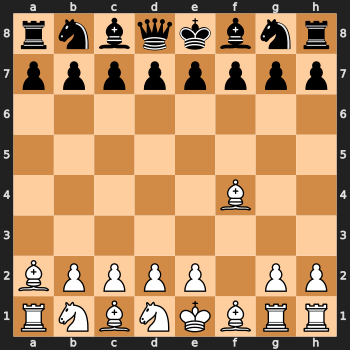

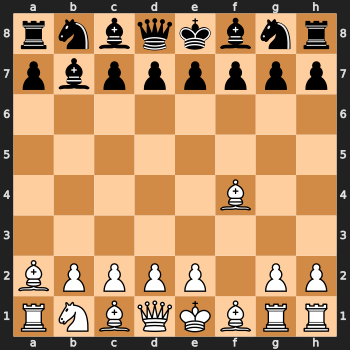

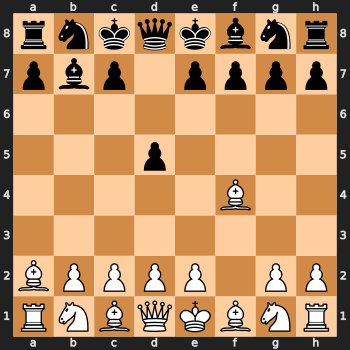

...

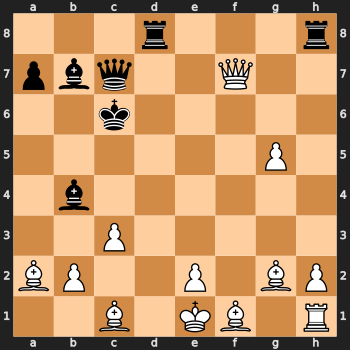

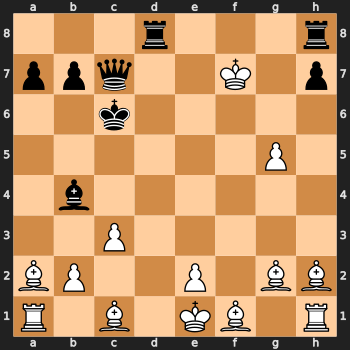

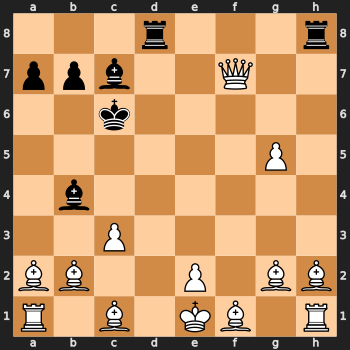

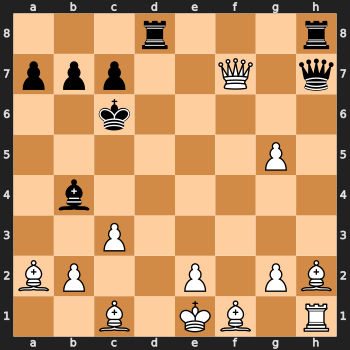

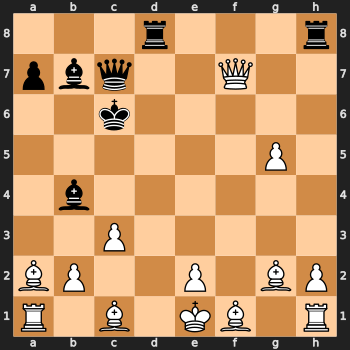

In [93]:
for rfen in rotated_fens:
        board = chess.Board(rfen)
        svg = chess.svg.board(board, size = 350)
        display(SVG(svg))

Results

In [94]:
output = []
for i in range(len(rotated_fens)-1):
    output.append(execute(rotated_fens[i], rotated_fens[i+1]))

Move made: Bxb8, Is black: False
Move made: fxd1, Is black: False
Move made: dxg1, Is black: True
Move made: Nxh2, Is black: False
Move made: dxf3, Is black: True
Move made: Bxh2, Is black: True
Move made: Rxe1, Is black: False
Move made: Nxe1, Is black: False
Move made: Nxh2, Is black: True
Move made: Nxb2, Is black: False
Move made: Rxd1, Is black: False
Move made: Bxh2, Is black: True
Move made: Bxd1, Is black: True
Move made: exe6, Is black: True
Move made: Nxh2, Is black: False
Move made: Rxh2, Is black: True
Move made: Bxd1, Is black: True
Move made: Rxd1, Is black: False
Move made: Qxh2, Is black: True
Move made: Nxh7, Is black: False
Move made: Qxd1, Is black: True
Move made: Nxh2, Is black: False
Move made: Bxh5, Is black: True
Move made: Nxh2, Is black: False
Move made: Nxe1, Is black: False
Move made: Nxd1, Is black: False
Move made: gxh2, Is black: True
Move made: Nxf5, Is black: True
Move made: Nxf1, Is black: False
Move made: Bxe1, Is black: True
Move made: exh2, Is black

In [95]:
realoutput = []
for out in output:
    if out != None: realoutput.append(out)
print(realoutput)

[['Bxb8', False], ['fxd1', False], ['dxg1', True], ['Nxh2', False], ['dxf3', True], ['Bxh2', True], ['Rxe1', False], ['Nxe1', False], ['Nxh2', True], ['Nxb2', False], ['Rxd1', False], ['Bxh2', True], ['Bxd1', True], ['exe6', True], ['Nxh2', False], ['Rxh2', True], ['Bxd1', True], ['Rxd1', False], ['Qxh2', True], ['Nxh7', False], ['Qxd1', True], ['Nxh2', False], ['Bxh5', True], ['Nxh2', False], ['Nxe1', False], ['Nxd1', False], ['gxh2', True], ['Nxf5', True], ['Nxf1', False], ['Bxe1', True], ['exh2', True], ['dxd1', False], ['fxd1', True], ['axd1', True], ['Nxg2', True], ['Kxc2', False], ['Bxg2', True], ['Rxc2', False], ['Bxa1', True], ['Nxh2', True], ['Kxg2', False], ['Kxc2', True], ['Kxg2', False], ['Qxg2', True], ['Qxc2', True], ['Qxg2', True], ['hxh2', True], ['Bxg2', True], ['hxc2', True], ['hxg2', True], ['Kxg2', True], ['Bxf4', True], ['Qxf1', False], ['Qxf1', True], ['Qxh2', True], ['Qxh2', True], ['Rxg2', True], ['Qxg2', True], ['Qxc7', True], ['Rxc7', False], ['gxh2', True], [

In [96]:

for fen in fens:
    print(fen)

RRBKQBNR/PPPPPPPB/8/8/8/8/pppppppp/rnbkqbnr
RRBKQ1N1/PPPPPPPB/8/8/8/8/pppppp2/rnb3pp
RRBKNBNR/PP1PPPPB/8/2B5/8/8/pppppppp/rnbkqbnr
RRBKQBNR/PP1PPPPB/8/2B5/8/8/ppppppbp/rnbkqbnr
RNBKQBNR/PP1PPPPB/8/2B5/4p3/8/pppp1pbp/rnbkqknr
R1BKQBNR/BP1PPPBB/2N5/2P5/4p3/8/pppp1ppp/rnbkqbnr
R1BKQBNR/BP1PPPPB/2N5/2P5/4p3/8/pppp1ppp/rnbkqbnr
R1BKQBNR/BP1PPPPB/2P5/2P5/4p3/8/pppp1ppp/rnbkkknr
R1BKQBNR/BP1PPPPB/2N5/2P5/8/2b1p3/8/pqpp1ppp
R1BKQBNR/PP1PPPPB/2N5/2P5/2b1p3/8/pppp1npp/rnbkk1nr
R1BBQBN1/PP1PPPBB/2N5/2P5/2b1p3/8/pppp1pbp/rnbkq1nr
R1BKQB1R/PP1PPPBB/2N2N2/2P5/2p1p3/8/pppp1pbp/rnbkk1nr
R1BKQB1R/BP1PPPBB/2N2N2/2P5/2b1p3/5n2/pppp1ppp/rnbkk2r
R1BKQB1R/BP1PPPPB/2N5/2P5/2b1N3/5n2/pqpp1pbp/rnbkq2r
R1BKNB1R/BP1PPPPB/2N5/2P5/2b1N3/5n2/pppp1bpp/rnbkk2r
R1BKQB2/BP1PPPPB/2N5/2P5/2b1N3/5n2/pqpp1ppp/rnbkq2r
R1BKQB1R/BP1PPPPB/2N5/2P5/2b1N3/5n2/pqpp1bpp/rnbkk2r
R1BKQB1R/BP1PPPPB/2N5/2P5/2b1N3/5n2/pppp1ppp/rnbqk2r
R1BKQB1R/BP1PPPPB/2N5/2P5/2b1N3/5n2/pqpp1bbp/rnbkq2r
R1BKQB1R/PP1PPPPB/2N5/2P5/8/2b1N3/5n2/pppp1ppp
R1B